<a href="https://colab.research.google.com/github/anhtv26062000/AI_Challenge_2020/blob/main/source/Steganography_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Source Code

**1. Import Library**

In [ ]:
# Importing
import cv2
import numpy as np
import types
from google.colab.patches import cv2_imshow
import wave
import IPython.display as ipd

**2. Hide Data**

In [ ]:
def mess2Bin(message):
    if type(message) == str:
        return ''.join([format(ord(i), "08b") for i in message])
    elif type(message) == bytes or type(message) == np.ndarray:
        return [format(i,"08b") for i in message]
    elif type(message) == int or type(message) == np.uint8:
        return format(message,"08b")
    else:
        raise TypeError("Input không hợp lệ")
        
def hideData(image, message):
    """Tính số lượng byte cần encode"""
    n_bytes = image.shape[0] * image.shape[1]*3//8
    print ("Số lượng byte cần encode:",n_bytes)
    
    """Không thể nén message vào ảnh vì không đủ kích thước"""
    if len(message) > n_bytes:
        raise ValueError("Thông tin text quá lớn không thể lưu vào ảnh, cần ảnh lớn hơn hoặc giảm bớt thông tin lại!!!")
        
    message += "#####" # Có thể dùng tùy ý kí tự tách chuỗi
    data_index = 0
    
#     Convert mess 2 bin:
    bin_mess = mess2Bin(message)
    
    # Tìm độ dài chuỗi bit để encode
    data_len = len(bin_mess)
    for values in image:
        for pixel in values:
            """Convert RGB 2 Bin"""
            r,g,b = mess2Bin(pixel)
            """Bắt đầu chuyển dần bit phải nhất nếu vẫn ảnh vần còn lưu được"""
            if data_index < data_len:
                """Giấu ảnh vào red pixel với hệ nhị phân (2)"""
                pixel[0] = int(r[:-1] + bin_mess[data_index], 2)
                data_index += 1
            if data_index < data_len:
                """Giấu ảnh vào green pixel với hệ nhị phân (2)"""
                pixel[1] = int(g[:-1] + bin_mess[data_index], 2)
                data_index += 1
            if data_index < data_len:
                """Giấu ảnh vào blue pixel với hệ nhị phân (2)"""
                pixel[2] = int(b[:-1] + bin_mess[data_index], 2)
                data_index += 1
            # Khi hết data để encode
            if data_index >= data_len:
                break
    return image


def hideImage(img, img_hide):
    """Thay đổi size của ảnh giấu về cùng chiều với ảnh chứa """
    d = img.shape[1]
    h = img.shape[0]
    img_hide = cv2.resize(img_hide, (d,h))
    
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            """Convert 2 ảnh RGB 2 Bin"""
            r1,g1,b1 = mess2Bin(img[i][j])
            r2,g2,b2 = mess2Bin(img_hide[i][j])
            """Giấu 4 bit phải nhất của ảnh giấu sang 4 bit trái nhất ảnh chứa"""
            img[i][j][0] = int(r1[:4] +r2[:4],2)
            img[i][j][1] = int(g1[:4] +g2[:4],2)
            img[i][j][2] = int(b1[:4] +b2[:4],2)
    return img

**3. Show Data**

In [ ]:
def showData(image):
    bin_data = ""
    for values in image:
        for pixel in values:
            r,g,b = mess2Bin(pixel)
            bin_data += r[-1]
            bin_data += g[-1]
            bin_data += b[-1]
    
    """Tách mỗi 8 bit"""
    all_bytes = [bin_data[i:i+8] for i in range(0, len(bin_data), 8)]
    """Convert 8bit to characters"""
    decode_data = ""
    for byte in all_bytes:
        decode_data += chr(int(byte,2))
        if decode_data[-5:] == "#####": # Check nếu đến đoạn cắt
            break
    return decode_data[:-5]

def showImage(img):
    """Create new RGB image to storage output"""
    new_img = np.zeros((img.shape[0],img.shape[1],3), np.uint8)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            """Convert 2 ảnh RGB 2 Bin"""
            r1,g1,b1 = mess2Bin(img[i][j])
            new_img[i][j][0] = int(r1[4:] + "0000",2)
            new_img[i][j][1] = int(g1[4:] + "0000",2)
            new_img[i][j][2] = int(b1[4:] + "0000",2)
    return new_img

**4. Encode**

In [ ]:
def encode_text():
    img_name = input("Nhập tên file ảnh cover(bao gồm đuôi .png):\n")
    img = cv2.imread(img_name)
    
    # Info image
    print('Shape image: ',img.shape)
    print('Ảnh gốc: ')
    resized_img = cv2.resize(img, (500,500))
    cv2_imshow(resized_img) #display the image
    
    data = input('Nhập message cần giấu trong ảnh này:\n')
    if (len(data) == 0):
        raise ValueError("Message trống")
    
    file_name = input('Đặt tên file ảnh encoded(bao gồm đuôi .png):\n')
    encode_img = hideData(img, data)
    cv2.imwrite(file_name,encode_img)
    
def encode_img():
    img_name = input("Nhập tên file ảnh cover(bao gồm đuôi .png):\n")
    img = cv2.imread(img_name)
    
    # Info image
    print('Shape image: ',img.shape)
    print('Ảnh gốc: ')
    resized_img = cv2.resize(img, (500,500))
    cv2_imshow(resized_img)
    
    img_name_hide = input("Nhập tên file ảnh cần giấu(bao gồm đuôi .png):\n")
    img_hide = cv2.imread(img_name_hide)
    
    file_name = input('Đặt tên file ảnh encoded(bao gồm đuôi .png):\n')
    encode_img = hideImage(img,img_hide)
    cv2.imwrite(file_name, encode_img)

def encode_text_in_audio():
    # read wave audio file 
    song_name = input("Nhập tên file audio cover(bao gồm đuôi .wav):\n")
    song = wave.open(song_name, mode='rb')
    # Read frames and convert to byte array
    frame_bytes = bytearray(list(song.readframes(song.getnframes())))
    # The "secret" text message
    string = input('Nhập message cần giấu trong audio này:\n')
    if (len(string) == 0):
        raise ValueError("Message trống")
    # Append dummy data to fill out rest of the bytes. Receiver shall detect and remove these characters.
    string = string + int((len(frame_bytes)-(len(string)*8*8))/8) *'#'
    # Convert text to bit array
    bits = list(map(int, ''.join([bin(ord(i)).lstrip('0b').rjust(8,'0') for i in string])))
    # Replace LSB of each byte of the audio data by one bit from the text bit array
    for i, bit in enumerate(bits):
        frame_bytes[i] = (frame_bytes[i] & 254) | bit
    # Get the modified bytes
    frame_modified = bytes(frame_bytes)
    # Write bytes to a new wave audio file
    file_name = input('Đặt tên file encoded audio(bao gồm đuôi .wav):\n')
    with wave.open(file_name, 'wb') as fd:
        fd.setparams(song.getparams())
        fd.writeframes(frame_modified)
    song.close()

**5. Decode**

In [ ]:
def decode_text():
    img_name = input('Nhập tên file đã giấu thông tin trong ảnh(bao gồm đuôi .png):\n')
    img = cv2.imread(img_name)
    
    print('Ảnh đã giấu nó như thế này:')
    resized_img = cv2.resize(img,(500,500))
    
    cv2_imshow(resized_img)
    
    text = showData(img)
    return text

def decode_img():
    img_name = input('Nhập tên file đã giấu thông tin trong ảnh(bao gồm đuôi .png):\n')
    img = cv2.imread(img_name)
    print('Ảnh sau khi được giấu:')
    resized_img = cv2.resize(img,(500,500))
    cv2_imshow(resized_img)
    image_hide = showImage(img)
    return image_hide

def decode_text_in_audio():
    song_name = input('Nhập tên file đã giấu thông tin trong audio(bao gồm đuôi .wav):\n')
    song = wave.open(song_name, mode='rb')
    # Convert audio to byte array
    frame_bytes = bytearray(list(song.readframes(song.getnframes())))
    # Extract the LSB of each byte
    extracted = [frame_bytes[i] & 1 for i in range(len(frame_bytes))]
    # Convert byte array back to string
    string = "".join(chr(int("".join(map(str,extracted[i:i+8])),2)) for i in range(0,len(extracted),8))
    # Cut off at the filler characters
    decoded = string.split("###")[0]
    song.close()
    return decoded

**6. Hàm Main**

In [ ]:
def Steganography():
    a = input('Image Steganography with Least Significant Bit\n 1. Encode message \n 2. Decode message\n 3. Encode Image\n 4. Decode Image\n 5. Encode Audio\n 6. Decode Audio\n')
    
    userinput = int(a)
    if (userinput==1):
        print("\nEncoding mess...")
        encode_text()
    elif (userinput==2):
        print("\nDecoding mess...")
        print("Decoded message: "+ decode_text())
    elif (userinput==3):
        print("\nEncoding image...")
        encode_img()
    elif (userinput==4):
        print("\nDecoding image...")
        output = decode_img()
        resized_img = cv2.resize(output,(500,500))
        print('Ảnh đã giấu sau khi decode:')
        cv2_imshow(resized_img)
    elif (userinput==5):
        print("\nEncoding mess...")
        encode_text_in_audio()
    elif (userinput==6):
        print("\nDecoding mess...")
        print("Decoded message: "+ decode_text_in_audio())
    else:
        raise Exception("Nhập sai input rồi")

# Run demo code

**1. Giấu thông tin trong ảnh**

Image Steganography with Least Significant Bit
 1. Encode message 
 2. Decode message
 3. Encode Image
 4. Decode Image
 5. Encode Audio
 6. Decode Audio
1

Encoding mess...
Nhập tên file ảnh cover(bao gồm đuôi .png):
/content/drive/My Drive/Ảnh/squirrel.png
Shape image:  (564, 564, 3)
Ảnh gốc: 


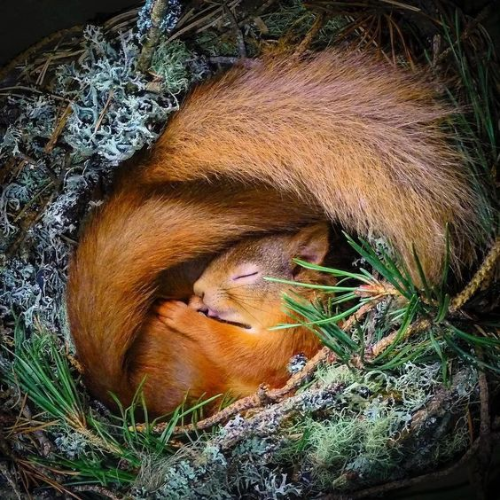

Nhập message cần giấu trong ảnh này:
Bao cao do an Tinh toan da phuong tien
Đặt tên file ảnh encoded(bao gồm đuôi .png):
/content/drive/My Drive/Ảnh/squirrel-encode.png
Số lượng byte cần encode: 119286


In [ ]:
Steganography()

**2. Giải mã thông tin từ ảnh đã được giấu**

Image Steganography with Least Significant Bit
 1. Encode message 
 2. Decode message
 3. Encode Image
 4. Decode Image
 5. Encode Audio
 6. Decode Audio
2

Decoding mess...
Nhập tên file đã giấu thông tin trong ảnh(bao gồm đuôi .png):
/content/drive/My Drive/Ảnh/squirrel-encode.png
Ảnh đã giấu nó như thế này:


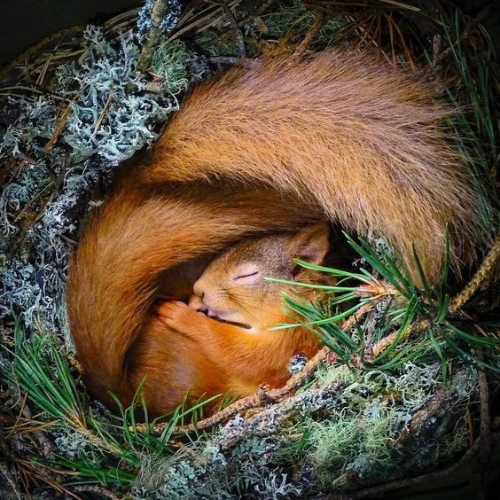

Decoded message: Bao cao do an Tinh toan da phuong tien


In [ ]:
Steganography()

**3. Giấu ảnh trong bức ảnh khác**

Image Steganography with Least Significant Bit
 1. Encode message 
 2. Decode message
 3. Encode Image
 4. Decode Image
 5. Encode Audio
 6. Decode Audio
3

Encoding image...
Nhập tên file ảnh cover(bao gồm đuôi .png):
/content/drive/My Drive/Ảnh/Venezia.png
Shape image:  (705, 564, 3)
Ảnh gốc: 


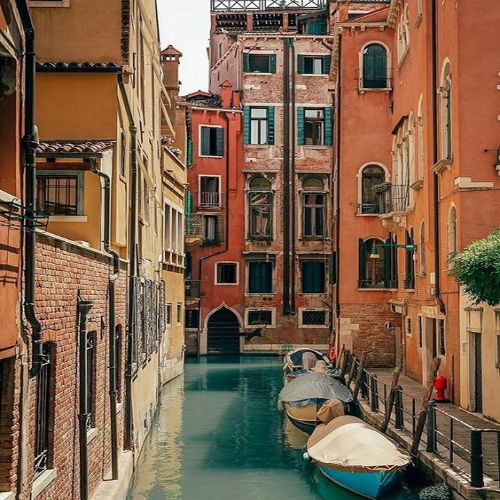

Nhập tên file ảnh cần giấu(bao gồm đuôi .png):
/content/drive/My Drive/Ảnh/puppy.png
Đặt tên file ảnh encoded(bao gồm đuôi .png):
/content/drive/My Drive/Ảnh/Vene_puppy.png


In [ ]:
Steganography()

**4. Giải mã ảnh trong bức ảnh khác**

Image Steganography with Least Significant Bit
 1. Encode message 
 2. Decode message
 3. Encode Image
 4. Decode Image
 5. Encode Audio
 6. Decode Audio
4

Decoding image...
Nhập tên file đã giấu thông tin trong ảnh(bao gồm đuôi .png):
/content/drive/My Drive/Ảnh/Vene_puppy.png
Ảnh sau khi được giấu:


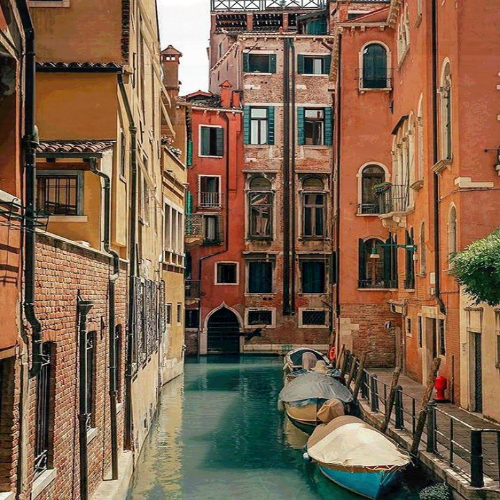

Ảnh đã giấu sau khi decode:


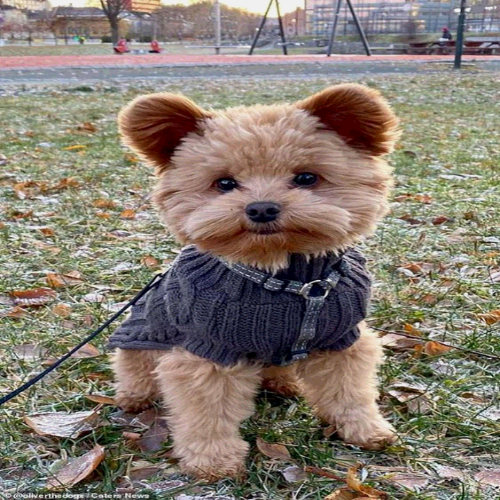

In [ ]:
Steganography()

**5. Giấu thông tin vào file âm thanh**

In [ ]:
Steganography()

Image Steganography with Least Significant Bit
 1. Encode message 
 2. Decode message
 3. Encode Image
 4. Decode Image
 5. Encode Audio
 6. Decode Audio
5

Encoding mess...
Nhập tên file audio cover(bao gồm đuôi .wav):
audio.wav
Nhập message cần giấu trong audio này:
Chao mung thay Tiep da den voi Source Code cua nhom !!!
Đặt tên file encoded audio(bao gồm đuôi .wav):
audio_cothongtin.wav


In [ ]:
print('Đoạn nhạc gốc:\n')
songname='audio.wav'
ipd.Audio(songname)

In [ ]:
print('Đoạn nhạc sau khi được nhúng thông điệp:\n')
songname='audio_cothongtin.wav'
ipd.Audio(songname)

Đoạn nhạc sau khi được nhúng thông điệp:



**6. Giải mã thông tin được giấu vào file âm thanh**

In [ ]:
Steganography()

Image Steganography with Least Significant Bit
 1. Encode message 
 2. Decode message
 3. Encode Image
 4. Decode Image
 5. Encode Audio
 6. Decode Audio
6

Decoding mess...
Nhập tên file đã giấu thông tin trong audio(bao gồm đuôi .wav):
audio_cothongtin.wav
Decoded message: Chao mung thay Tiep da den voi Source Code cua nhom !!!
